In [352]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

# 1. Load your Excel data
df = pd.read_excel("/Users/szelie/data/unu/occurrence_data-1.xlsx", sheet_name='Data')

# 2. Convert to GeoDataFrame
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf_all = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")



# 3. Load world country boundaries
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# 4. Spatial join to assign countries
gdf_with_country = gpd.sjoin(gdf, world, how="inner", predicate="within")

# 5. Filter only Mexico and Guatemala

# 6. Drop duplicates and unnecessary columns
gdf_with_country = gdf_with_country.drop_duplicates(subset=['lon', 'lat'])




/var/folders/f5/lms0b90j1kx7kk4v552qkjqw0000gp/T/ipykernel_58583/3082509566.py:15: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
/var/folders/f5/lms0b90j1kx7kk4v552qkjqw0000gp/T/ipykernel_58583/3082509566.py:18: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3857
Right CRS: EPSG:4326

  gdf_with_country = gpd.sjoin(gdf, world, how="inner", predicate="within")


In [196]:
gdf_all


,acronym,family,species,lon,lat,source,url,main_use,neotropical,geometry
0,ACACHI,Leguminosae,Acacia hindsii,-106.628425,24.116028,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-106.62842 24.11603)
1,ACACHI,Leguminosae,Acacia hindsii,-106.626391,24.120866,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-106.62639 24.12087)
2,ACACHI,Leguminosae,Acacia hindsii,-106.630435,24.122308,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-106.63044 24.12231)
3,ACACHI,Leguminosae,Acacia hindsii,-93.101326,16.633986,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-93.10133 16.63399)
4,ACACHI,Leguminosae,Acacia hindsii,-92.340117,17.167102,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-92.34012 17.16710)
...,...,...,...,...,...,...,...,...,...,...
136898,COFFAR,Rubiaceae,Coffea arabica,-85.350000,10.770000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-85.35000 10.77000)
136899,COFFAR,Rubiaceae,Coffea arabica,-87.040000,5.550000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-87.04000 5.55000)
136900,COFFAR,Rubiaceae,Coffea arabica,-83.050000,9.410000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-83.05000 9.41000)
136901,COFFAR,Rubiaceae,Coffea arabica,-84.260000,9.910000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-84.26000 9.91000)


In [195]:
gdf = gdf_all[(gdf_all.species == 'Theobroma cacao') | (gdf_all.species == 'Coffea arabica')]


<Axes: >

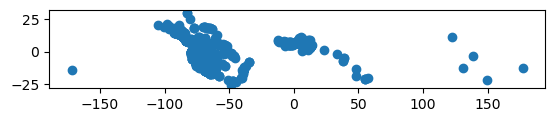

In [173]:
gdf.plot()

In [347]:
gdf_all

,acronym,family,species,lon,lat,source,url,main_use,neotropical,geometry
0,ACACHI,Leguminosae,Acacia hindsii,-106.628425,24.116028,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-11869821.975 2767553.014)
1,ACACHI,Leguminosae,Acacia hindsii,-106.626391,24.120866,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-11869595.551 2768143.089)
2,ACACHI,Leguminosae,Acacia hindsii,-106.630435,24.122308,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-11870045.727 2768318.970)
3,ACACHI,Leguminosae,Acacia hindsii,-93.101326,16.633986,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-10363992.202 1878260.124)
4,ACACHI,Leguminosae,Acacia hindsii,-92.340117,17.167102,GBIF,https://www.gbif.org/occurrence/search?q=,N-fixing,Yes,POINT (-10279254.804 1940285.400)
...,...,...,...,...,...,...,...,...,...,...
136898,COFFAR,Rubiaceae,Coffea arabica,-85.350000,10.770000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-9501118.539 1206034.207)
136899,COFFAR,Rubiaceae,Coffea arabica,-87.040000,5.550000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-9689248.479 618791.617)
136900,COFFAR,Rubiaceae,Coffea arabica,-83.050000,9.410000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-9245083.710 1052257.576)
136901,COFFAR,Rubiaceae,Coffea arabica,-84.260000,9.910000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,No,POINT (-9379780.294 1108718.070)


In [353]:
import geopandas as gpd
import rasterio
from shapely.geometry import box
import pandas as pd

# List of all your canopy raster tiles (expand this with all you downloaded)
tiles = [
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N12W084_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N12W087_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N12W090_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N12W093_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N15W090_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N15W093_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W075_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W096_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W099_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W102_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W105_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W069_Map.tif",
    "/Users/szelie/data/unu/canopy/ETH_GlobalCanopyHeight_10m_2020_N18W072_Map.tif"
]

results = []

# gdf should already be defined with your observations

for tile in tiles:
    with rasterio.open(tile) as src:
        # Reproject to raster CRS
        gdf_rp = gdf_all.to_crs(src.crs)

        # Filter points inside raster bounds
        bounds = box(*src.bounds)
        gdf_in_tile = gdf_rp[gdf_rp.geometry.within(bounds)]
        if gdf_in_tile.empty:
            continue

        # Sample raster values
        coords = [(geom.x, geom.y) for geom in gdf_in_tile.geometry]
        values = list(src.sample(coords))
        gdf_in_tile["canopy_value"] = [val[0] for val in values]

        # Optional filter, you already commented this out
        # gdf_in_tile = gdf_in_tile[(gdf_in_tile.canopy_value > 0) & (gdf_in_tile.canopy_value < 255)]

        results.append(gdf_in_tile)

# Combine results if any
if results:
    gdf_combined = gpd.GeoDataFrame(pd.concat(results), crs=gdf_all.crs)
    gdf_combined.to_file("species_with_canopy_values.gpkg", driver="GPKG")
    print(gdf_combined.head())
else:
    print("No matching points found in any of the tiles.")


/Users/szelie/miniforge3/envs/climada_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/Users/szelie/miniforge3/envs/climada_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/Users/szelie/miniforge3/envs/climada_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to b

     acronym         family                 species    lon    lat source  \
3405  ANACOC  Anacardiaceae  Anacardium occidentale -83.33  14.10   GBIF   
3407  ANACOC  Anacardiaceae  Anacardium occidentale -83.40  14.02   GBIF   
3414  ANACOC  Anacardiaceae  Anacardium occidentale -83.68  14.75   GBIF   
3415  ANACOC  Anacardiaceae  Anacardium occidentale -83.68  12.32   GBIF   
3421  ANACOC  Anacardiaceae  Anacardium occidentale -83.77  12.03   GBIF   

                                    url main_use neotropical  \
3405  http://doi.org/10.15468/dl.yihmyo    Fruit         Yes   
3407  http://doi.org/10.15468/dl.yihmyo    Fruit         Yes   
3414  http://doi.org/10.15468/dl.yihmyo    Fruit         Yes   
3415  http://doi.org/10.15468/dl.yihmyo    Fruit         Yes   
3421  http://doi.org/10.15468/dl.yihmyo    Fruit         Yes   

                        geometry  canopy_value  
3405  POINT (-83.33000 14.10000)             9  
3407  POINT (-83.40000 14.02000)             9  
3414  POINT

In [354]:
gdf_combined

,acronym,family,species,lon,lat,source,url,main_use,neotropical,geometry,canopy_value
3405,ANACOC,Anacardiaceae,Anacardium occidentale,-83.330000,14.100000,GBIF,http://doi.org/10.15468/dl.yihmyo,Fruit,Yes,POINT (-83.33000 14.10000),9
3407,ANACOC,Anacardiaceae,Anacardium occidentale,-83.400000,14.020000,GBIF,http://doi.org/10.15468/dl.yihmyo,Fruit,Yes,POINT (-83.40000 14.02000),9
3414,ANACOC,Anacardiaceae,Anacardium occidentale,-83.680000,14.750000,GBIF,http://doi.org/10.15468/dl.yihmyo,Fruit,Yes,POINT (-83.68000 14.75000),10
3415,ANACOC,Anacardiaceae,Anacardium occidentale,-83.680000,12.320000,GBIF,http://doi.org/10.15468/dl.yihmyo,Fruit,Yes,POINT (-83.68000 12.32000),15
3421,ANACOC,Anacardiaceae,Anacardium occidentale,-83.770000,12.030000,GBIF,http://doi.org/10.15468/dl.yihmyo,Fruit,Yes,POINT (-83.77000 12.03000),8
...,...,...,...,...,...,...,...,...,...,...,...
133495,TAMAIN,Leguminosae,Tamarindus indica,-69.220000,18.480000,GBIF,https://www.gbif.org/occurrence/search?q=,Fruit,No,POINT (-69.22000 18.48000),14
133825,TAMAIN,Leguminosae,Tamarindus indica,-69.016029,18.348354,GBIF,https://www.gbif.org/occurrence/search?q=,Fruit,No,POINT (-69.01603 18.34835),14
135174,THEOCA,Malvaceae,Theobroma cacao,-69.500000,19.083300,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-69.50000 19.08330),25
135450,THEOCA,Malvaceae,Theobroma cacao,-70.270000,19.050000,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-70.27000 19.05000),21


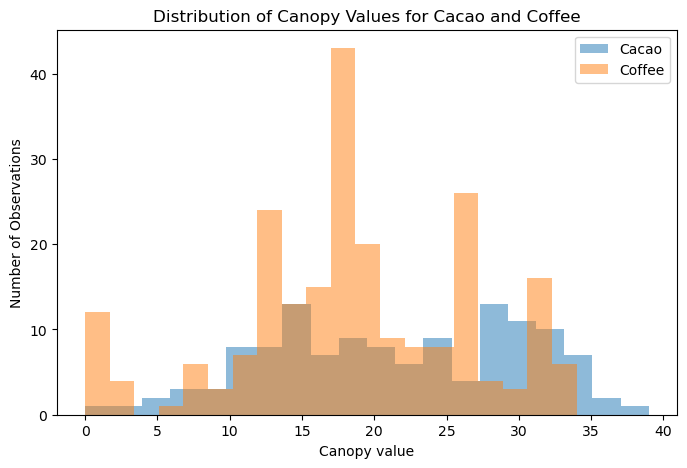

In [358]:
import matplotlib.pyplot as plt

gdf_combined = gdf_combined[gdf_combined.canopy_value<250]
# Filter for cacao and coffee
cacao = gdf_combined[gdf_combined.species == 'Theobroma cacao']
coffee = gdf_combined[gdf_combined.species == 'Coffea arabica']

# Plot
plt.figure(figsize=(8, 5))
plt.hist(cacao.canopy_value, bins=20, alpha=0.5, label='Cacao')
plt.hist(coffee.canopy_value, bins=20, alpha=0.5, label='Coffee')
plt.xlabel("Canopy value")
plt.ylabel("Number of Observations")
plt.title("Distribution of Canopy Values for Cacao and Coffee")
plt.legend()
plt.show()


In [374]:
import folium
import geopandas as gpd

# Reproject to WGS84 (Lat/Lon)
gdf_latlon = gdf_combined.to_crs(epsg=4326)

# Get center
centroid = gdf_latlon.unary_union.centroid
m = folium.Map(location=[centroid.y, centroid.x], zoom_start=12, tiles=None)

# Add satellite tiles (Esri)
folium.TileLayer(
    tiles="https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}",
    attr="Esri World Imagery",
    name="Esri Satellite",
    overlay=False,
    control=True
).add_to(m)

# Add points
for idx, row in gdf_latlon.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue',
        popup=f"Canopy Value: {row['canopy_value']}"
    ).add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

m

In [375]:
gdf_combined.columns

Index(['acronym', 'family', 'species', 'lon', 'lat', 'source', 'url',
       'main_use', 'neotropical', 'geometry', 'canopy_value'],
      dtype='object')

<Figure size 2000x10100 with 0 Axes>

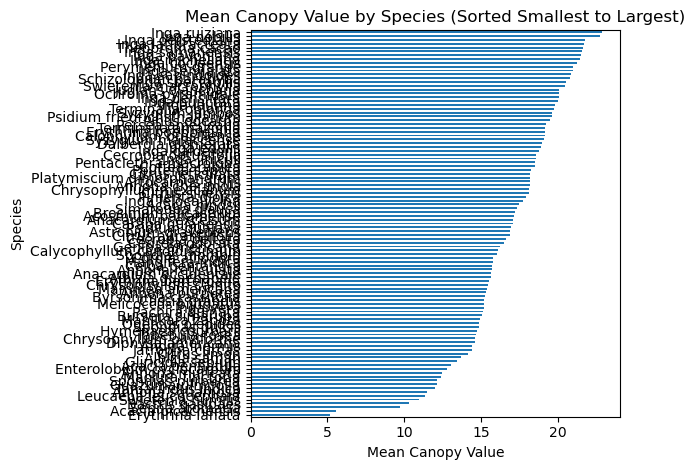

In [376]:
# Compute means and sort from smallest to largest
species_means = gdf_combined[["species", "canopy_value"]].groupby("species").mean().sort_values("canopy_value")

# Plot with better spacing
plt.figure(figsize=(20, len(species_means)))  # Adjust height based on number of species
species_means.plot(kind='barh', legend=False)
plt.xlabel("Mean Canopy Value")
plt.ylabel("Species")
plt.title("Mean Canopy Value by Species (Sorted Smallest to Largest)")
plt.grid(False)  # Optional: Remove grid for cleaner look
plt.tight_layout()

species
Inga sapindoides        216
Inga calderonii         207
Inga spectabilis        201
Inga semialata          167
Inga edulis             159
Inga densiflora         126
Inga nobilis             69
Guazuma ulmifolia        58
Citrus aurantiifolia     52
Coffea arabica           52
dtype: int64


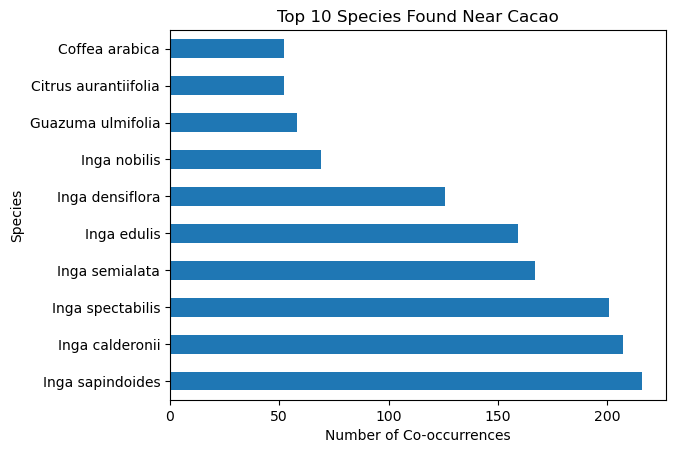

In [334]:
import geopandas as gpd

# Load and project your data (if not already projected)
gdf_all = gdf_all.to_crs(epsg=3857)
# Split into cacao and other species
cacao = gdf_all[gdf_all.species == 'Theobroma cacao']
others = gdf_all[gdf_all.species != 'Theobroma cacao']
# Create buffers around cacao points
cacao_buffer = cacao.copy()
cacao_buffer=cacao_buffer.drop(columns=
                  ['species'])

cacao_buffer['geometry'] = cacao_buffer.geometry.buffer(10
                                                       )  # 500m buffer
# Spatial join to find species intersecting cacao buffers
joined = gpd.sjoin(others, cacao_buffer, how="inner", predicate="intersects")
# Group by species and count occurrences
cooccurrence_counts = joined.groupby('species').size().sort_values(ascending=False)

# Display top co-occurring species
print(cooccurrence_counts.head(10))

import matplotlib.pyplot as plt

cooccurrence_counts.head(10).plot(kind='barh')
plt.xlabel("Number of Co-occurrences")
plt.ylabel("Species")
plt.title("Top 10 Species Found Near Cacao")
plt.show()


In [337]:
# to try: can we cluster area with similar species co-occurence?


In [299]:
cacao

,acronym,family,species,lon,lat,source,url,main_use,neotropical,geometry,cluster
134931,THEOCA,Malvaceae,Theobroma cacao,-48.4154,-2.0489,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-5389577.675 -228131.132),NaN
134932,THEOCA,Malvaceae,Theobroma cacao,-39.3653,-14.7197,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-4382125.151 -1656917.594),NaN
134933,THEOCA,Malvaceae,Theobroma cacao,-39.3661,-14.7203,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-4382214.207 -1656986.653),NaN
134934,THEOCA,Malvaceae,Theobroma cacao,-39.3658,-14.7203,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-4382180.811 -1656986.653),NaN
134935,THEOCA,Malvaceae,Theobroma cacao,-39.3661,-14.7206,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-4382214.207 -1657021.182),NaN
...,...,...,...,...,...,...,...,...,...,...,...
136111,THEOCA,Malvaceae,Theobroma cacao,33.4583,-2.1250,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (3724560.919 -236608.168),NaN
136112,THEOCA,Malvaceae,Theobroma cacao,3.5417,9.0417,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (394260.241 1010721.220),NaN
136113,THEOCA,Malvaceae,Theobroma cacao,-0.7083,6.0417,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (-78847.595 673808.828),NaN
136114,THEOCA,Malvaceae,Theobroma cacao,12.1250,8.6250,GBIF,https://www.gbif.org/occurrence/search?q=,Crop,Yes,POINT (1349748.826 963777.489),NaN
